## 作業

1. 如何使用已經訓練好的模型？
2. 依照 https://github.com/qqwweee/keras-yolo3 的程式碼，請敘述，訓練模型時，資料集的格式是什麼？具體一點的說，要提供什麼格式的文件來描述資料集的圖片以及 bboxes 的信息呢？





In [1]:
# %tensorflow_version 1.x # 確保 colob 中使用的 tensorflow 是 1.x 版本而不是 tensorflow 2
import tensorflow as tf
print(tf.__version__)

1.15.0


In [2]:
# pip install keras==2.2.4 # 需要安裝 keras 2.2.4 的版本

In [3]:
# !git clone https://github.com/qqwweee/keras-yolo3 # 如果之前已經下載過就可以註解掉
%cd keras-yolo3

/media/rogerchang/Data/python/cvdl/term_project/keras-yolo3


In [4]:
import os
from xml.etree import ElementTree
import numpy as np

In [5]:
if not os.path.exists('model_data/yolov3.h5'):
    # os.system('wget https://pjreddie.com/media/files/yolov3.weights')
    os.system('python convert.py yolov3.cfg yolov3.weights model_data/yolov3.h5')
else:
    pass

In [6]:
if not os.path.exists('animals_train.txt'):
    sets = ['train', 'val']
    
    classes = ["kangaroo", "raccoon"]
    
    def dump_info(xml_path, list_file):
        f = open(xml_path)
        tree = ElementTree.parse(f)
        root = tree.getroot()
        
        for obj in tree.iter('object'):
            diff = int(obj.find('difficult').text)
            cls_name = obj.find('name').text
            
            if cls_name not in classes or diff == 1:
                continue
                
            cls_index = classes.index(cls_name)
            bndbox = obj.find('bndbox')
            
            b = (int(bndbox.find('xmin').text), int(bndbox.find('ymin').text), int(bndbox.find('xmax').text), int(bndbox.find('ymax').text))
            list_file.write(" " + ",".join([str(a) for a in b]) + ',' + str(cls_index))
            
        f.close()
        
    
    images_dir = ['animals/kangaroo/images', 'animals/raccoon/images']
    for s in sets:
        list_file = open('animals_%s.txt' % s, 'w')
        
        for i, annotation_path in enumerate(['animals/kangaroo/annots', 'animals/raccoon/annotations']):
            annots = os.listdir(annotation_path)
            annots.sort()
            annot_size = len(annots)
            split_num = int(np.round(annot_size * 0.8))
        
            if s == 'train':
                data = annots[:split_num]
            else:
                data = annots[split_num:]
                
            for d in data:
                name = d.split('.')[0]
                list_file.write(os.path.join(images_dir[i], '%s.jpg' % name))
                dump_info(os.path.join(annotation_path, d), list_file)
                list_file.write('\n')
        
        list_file.close()
        

In [7]:
import keras.backend as K
from keras.layers import Input, Lambda
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import TensorBoard, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping

from yolo3.model import preprocess_true_boxes, yolo_body, tiny_yolo_body, yolo_loss
from yolo3.utils import get_random_data

import time

Using TensorFlow backend.


In [8]:
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [9]:
import tensorflow as tf
tf.logging.set_verbosity(tf.logging.ERROR)

config = tf.ConfigProto()
config.gpu_options.allow_growth = True
sess = tf.Session(config=config)

K.set_session(sess)

In [10]:
from train import get_classes, get_anchors, create_model, create_tiny_model

In [11]:
def data_generator(annotation_lines, batch_size, input_shape, anchors, num_classes, is_train=True):
    '''data generator for fit_generator'''
    n = len(annotation_lines)
    i = 0
    while True:
        image_data = []
        box_data = []
        for b in range(batch_size):
            if i==0 and is_train:
                np.random.shuffle(annotation_lines)
            image, box = get_random_data(annotation_lines[i], input_shape, random=is_train)
            image_data.append(image)
            box_data.append(box)
            i = (i+1) % n
        image_data = np.array(image_data)
        box_data = np.array(box_data)
        y_true = preprocess_true_boxes(box_data, input_shape, anchors, num_classes)
        yield [image_data, *y_true], np.zeros(batch_size)

In [12]:
annotation_path = 'animals_train.txt' # 轉換好格式的標註檔案
log_dir = 'logs/%s/' % str(int(time.time()))# 訓練好的模型儲存的路徑
classes_path = 'model_data/animal_classes.txt'
anchors_path = 'model_data/yolo_anchors.txt'
class_names = get_classes(classes_path)
num_classes = len(class_names)
anchors = get_anchors(anchors_path)

input_shape = (416,416) # multiple of 32, hw

is_tiny_version = len(anchors)==6 # default setting
if is_tiny_version:
    model = create_tiny_model(input_shape, anchors, num_classes,
        freeze_body=2, weights_path='model_data/tiny_yolo.h5')
else:
    model = create_model(input_shape, anchors, num_classes, 
        freeze_body=2, weights_path='model_data/Day41_trained_weights.h5') # make sure you know what you freeze

logging = TensorBoard(log_dir=log_dir)
checkpoint = ModelCheckpoint(log_dir + 'ep{epoch:03d}-loss{loss:.3f}-val_loss{val_loss:.3f}.h5',
    monitor='val_loss', save_weights_only=True, save_best_only=True, period=3)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=10, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0, patience=20, verbose=1)

# 分為 training 以及 validation
val_split = 0.1
with open(annotation_path) as f:
    train_lines = f.readlines()
with open('animals_val.txt') as f:
    val_lines = f.readlines()
np.random.seed(10101)
np.random.shuffle(train_lines)
np.random.seed(None)
num_val = len(val_lines)
num_train = len(train_lines)

Create YOLOv3 model with 9 anchors and 2 classes.


/home/rogerchang/anaconda3/envs/tensorflow/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_59 due to mismatch in shape ((1, 1, 1024, 21) vs (75, 1024, 1, 1)).
  weight_values[i].shape))
/home/rogerchang/anaconda3/envs/tensorflow/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_59 due to mismatch in shape ((21,) vs (75,)).
  weight_values[i].shape))
/home/rogerchang/anaconda3/envs/tensorflow/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_67 due to mismatch in shape ((1, 1, 512, 21) vs (75, 512, 1, 1)).
  weight_values[i].shape))
/home/rogerchang/anaconda3/envs/tensorflow/lib/python3.6/site-packages/keras/engine/saving.py:1140: UserWarning: Skipping loading of weights for layer conv2d_67 due to mismatch in shape ((21,) vs (75,)).
  weight_values[i].shape))
/home/rogerchang/anaconda3/envs/te

Load weights model_data/Day41_trained_weights.h5.
Freeze the first 249 layers of total 252 layers.


In [13]:
# Train with frozen layers first, to get a stable loss.
# Adjust num epochs to your dataset. This step is enough to obtain a not bad model.
# 一開始先 freeze YOLO 除了 output layer 以外的 darknet53 backbone 來 train
if True:
    model.compile(optimizer=Adam(lr=1e-3), loss={
        # use custom yolo_loss Lambda layer.
        'yolo_loss': lambda y_true, y_pred: y_pred})

    batch_size = 4
    print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
    # 模型利用 generator 產生的資料做訓練，強烈建議大家去閱讀及理解 data_generator_wrapper 在 train.py 中的實現
    history = model.fit_generator(data_generator(train_lines, batch_size, input_shape, anchors, num_classes, True),
            steps_per_epoch=max(1, num_train//batch_size),
            validation_data=data_generator(val_lines, batch_size, input_shape, anchors, num_classes, False),
            validation_steps=max(1, num_val//batch_size),
            epochs=100,
            initial_epoch=0,
            callbacks=[logging, checkpoint])
    model.save_weights(log_dir + 'trained_weights_stage_1.h5')

Train on 291 samples, val on 73 samples, with batch size 4.
Epoch 1/100
72/72 [==============================] - 14s 194ms/step - loss: 1739.5000 - val_loss: 177.4078
Epoch 2/100
72/72 [==============================] - 11s 151ms/step - loss: 152.0387 - val_loss: 87.7156
Epoch 3/100
72/72 [==============================] - 11s 155ms/step - loss: 89.9153 - val_loss: 58.1225
Epoch 4/100
72/72 [==============================] - 11s 150ms/step - loss: 63.0491 - val_loss: 44.6644
Epoch 5/100
72/72 [==============================] - 11s 155ms/step - loss: 49.2551 - val_loss: 36.8862
Epoch 6/100
72/72 [==============================] - 11s 155ms/step - loss: 42.1918 - val_loss: 32.0939
Epoch 7/100
72/72 [==============================] - 11s 152ms/step - loss: 36.3876 - val_loss: 28.4745
Epoch 8/100
72/72 [==============================] - 11s 155ms/step - loss: 33.2809 - val_loss: 26.4306
Epoch 9/100
72/72 [==============================] - 11s 155ms/step - loss: 30.5600 - val_loss: 24.5891


72/72 [==============================] - 11s 152ms/step - loss: 15.8099 - val_loss: 15.5235
Epoch 79/100
72/72 [==============================] - 11s 153ms/step - loss: 15.9860 - val_loss: 15.5632
Epoch 80/100
72/72 [==============================] - 11s 152ms/step - loss: 15.7422 - val_loss: 15.3187
Epoch 81/100
72/72 [==============================] - 11s 152ms/step - loss: 15.8750 - val_loss: 15.5351
Epoch 82/100
72/72 [==============================] - 11s 152ms/step - loss: 15.9512 - val_loss: 15.2728
Epoch 83/100
72/72 [==============================] - 11s 152ms/step - loss: 16.1959 - val_loss: 15.5565
Epoch 84/100
72/72 [==============================] - 11s 152ms/step - loss: 16.5189 - val_loss: 15.3909
Epoch 85/100
72/72 [==============================] - 11s 151ms/step - loss: 15.6025 - val_loss: 15.2813
Epoch 86/100
72/72 [==============================] - 11s 152ms/step - loss: 16.0426 - val_loss: 15.2750
Epoch 87/100
72/72 [==============================] - 11s 153ms/step

In [14]:
# Unfreeze and continue training, to fine-tune.
# Train longer if the result is not good.
if True:
    # 把所有 layer 都改為 trainable
    for i in range(len(model.layers)):
        model.layers[i].trainable = True
    model.compile(optimizer=Adam(lr=1e-4), loss={'yolo_loss': lambda y_true, y_pred: y_pred}) # recompile to apply the change
    print('Unfreeze all of the layers.')

    batch_size = 4 # note that more GPU memory is required after unfreezing the body
    print('Train on {} samples, val on {} samples, with batch size {}.'.format(num_train, num_val, batch_size))
    history2 = model.fit_generator(data_generator(train_lines, batch_size, input_shape, anchors, num_classes, True),
        steps_per_epoch=max(1, num_train//batch_size),
        validation_data=data_generator(val_lines, batch_size, input_shape, anchors, num_classes, False),
        validation_steps=max(1, num_val//batch_size),
        epochs=200,
        initial_epoch=100,
        callbacks=[logging, checkpoint, reduce_lr, early_stopping])
    model.save_weights(log_dir + 'trained_weights_final.h5')

Unfreeze all of the layers.
Train on 291 samples, val on 73 samples, with batch size 4.
Epoch 101/200
72/72 [==============================] - 24s 332ms/step - loss: 16.1987 - val_loss: 15.4883
Epoch 102/200
72/72 [==============================] - 18s 252ms/step - loss: 15.3537 - val_loss: 15.5104
Epoch 103/200
72/72 [==============================] - 18s 253ms/step - loss: 14.9590 - val_loss: 14.3978
Epoch 104/200
72/72 [==============================] - 18s 253ms/step - loss: 15.3069 - val_loss: 15.1601
Epoch 105/200
72/72 [==============================] - 18s 253ms/step - loss: 14.8283 - val_loss: 14.4367
Epoch 106/200
72/72 [==============================] - 18s 254ms/step - loss: 14.9056 - val_loss: 14.5714
Epoch 107/200
72/72 [==============================] - 18s 254ms/step - loss: 14.1117 - val_loss: 14.6234
Epoch 108/200
72/72 [==============================] - 18s 254ms/step - loss: 14.2638 - val_loss: 14.6061
Epoch 109/200
72/72 [==============================] - 18s 254ms

72/72 [==============================] - 18s 255ms/step - loss: 11.7134 - val_loss: 12.9598

Epoch 00177: ReduceLROnPlateau reducing learning rate to 9.999999747378752e-06.
Epoch 178/200
72/72 [==============================] - 18s 255ms/step - loss: 11.3584 - val_loss: 12.5085
Epoch 179/200
72/72 [==============================] - 18s 255ms/step - loss: 11.3666 - val_loss: 12.3945
Epoch 180/200
72/72 [==============================] - 18s 254ms/step - loss: 11.0293 - val_loss: 12.3337
Epoch 181/200
72/72 [==============================] - 18s 254ms/step - loss: 10.9906 - val_loss: 12.3335
Epoch 182/200
72/72 [==============================] - 18s 254ms/step - loss: 11.0050 - val_loss: 12.2958
Epoch 183/200
72/72 [==============================] - 18s 254ms/step - loss: 11.0879 - val_loss: 12.2152
Epoch 184/200
72/72 [==============================] - 18s 257ms/step - loss: 10.7730 - val_loss: 12.2701
Epoch 185/200
72/72 [==============================] - 18s 254ms/step - loss: 10.8159

In [15]:
from yolo import YOLO
yolo_model = YOLO(model_path=log_dir + 'trained_weights_final.h5', classes_path=classes_path)

logs/1582949709/trained_weights_final.h5 model, anchors, and classes loaded.


In [16]:
from PIL import Image
from IPython import display

(416, 416, 3)
Found 1 boxes for img
raccoon 1.00 (166, 29) (655, 523)
1.7250325809982314


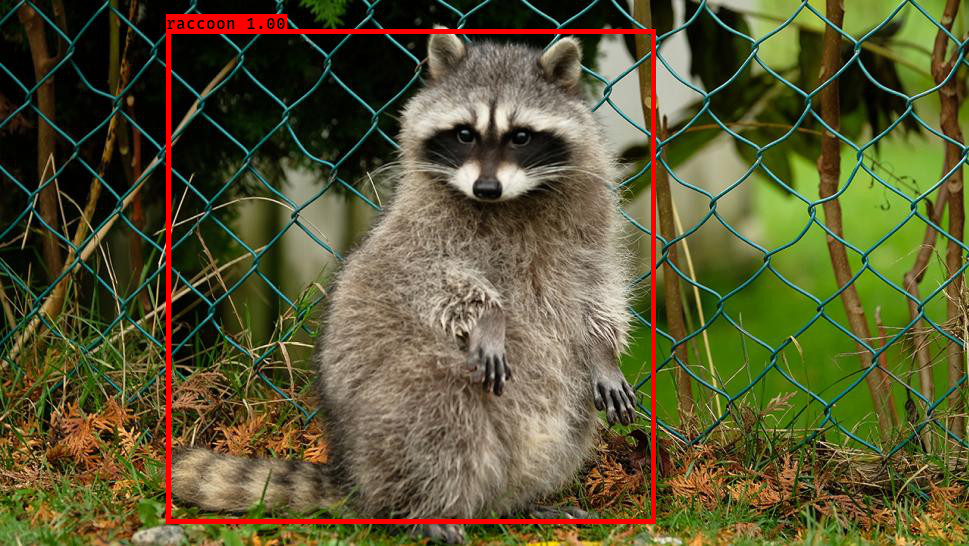

(416, 416, 3)
Found 1 boxes for img
raccoon 0.99 (0, 0) (431, 406)
0.03782469400175614


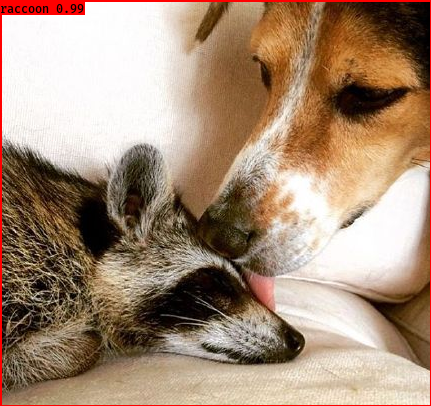

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.99 (51, 44) (137, 189)
0.033579134000319755


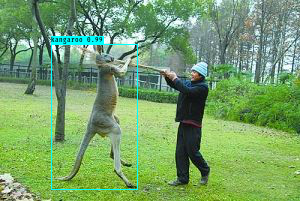

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.82 (21, 23) (530, 603)
0.04139033499814104


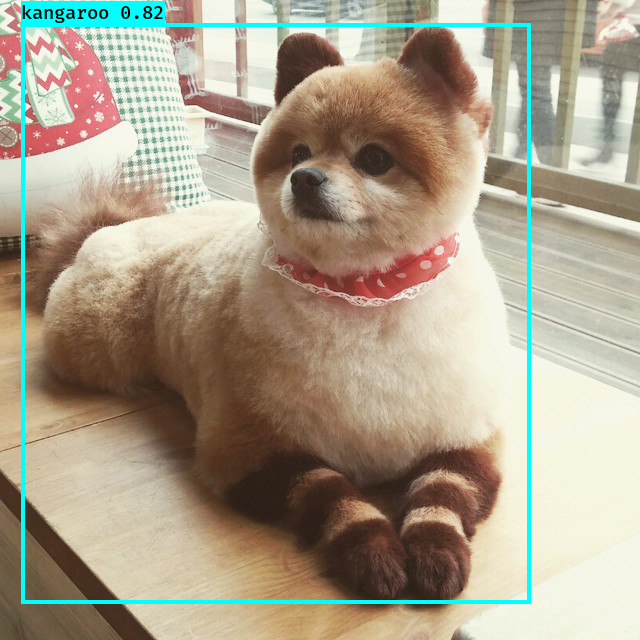

(416, 416, 3)
Found 2 boxes for img
raccoon 0.94 (487, 123) (698, 485)
raccoon 0.99 (74, 109) (572, 512)
0.038003188998118276


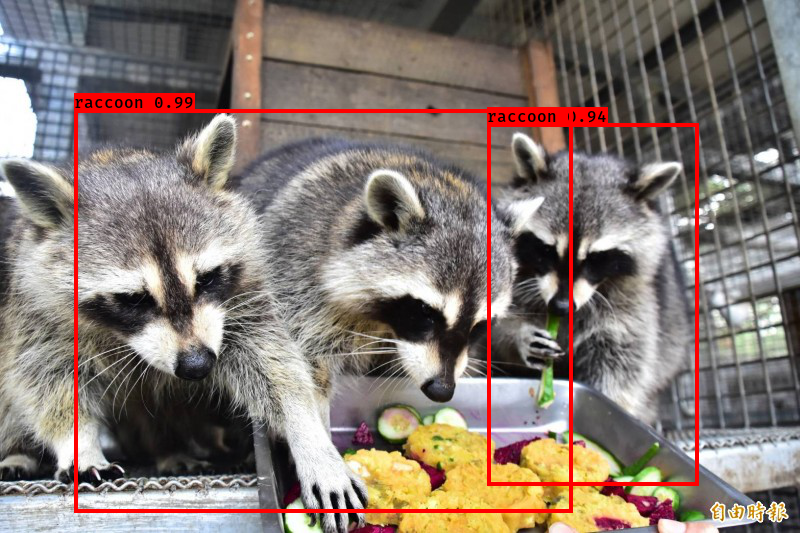

(416, 416, 3)
Found 2 boxes for img
kangaroo 0.45 (0, 0) (340, 613)
kangaroo 0.99 (298, 0) (614, 614)
0.03685595199931413


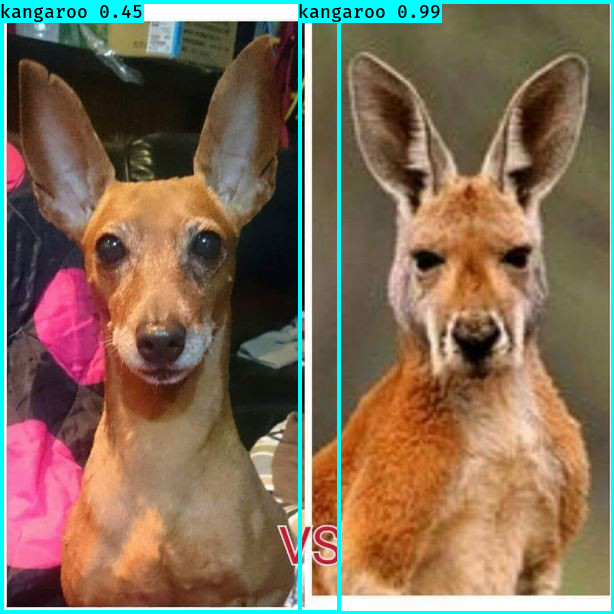

(416, 416, 3)
Found 6 boxes for img
kangaroo 0.32 (63, 241) (103, 280)
kangaroo 0.67 (155, 124) (375, 371)
kangaroo 0.70 (443, 308) (586, 490)
kangaroo 0.81 (48, 234) (114, 287)
kangaroo 0.93 (859, 210) (944, 360)
kangaroo 1.00 (133, 32) (671, 481)
0.04380363499876694


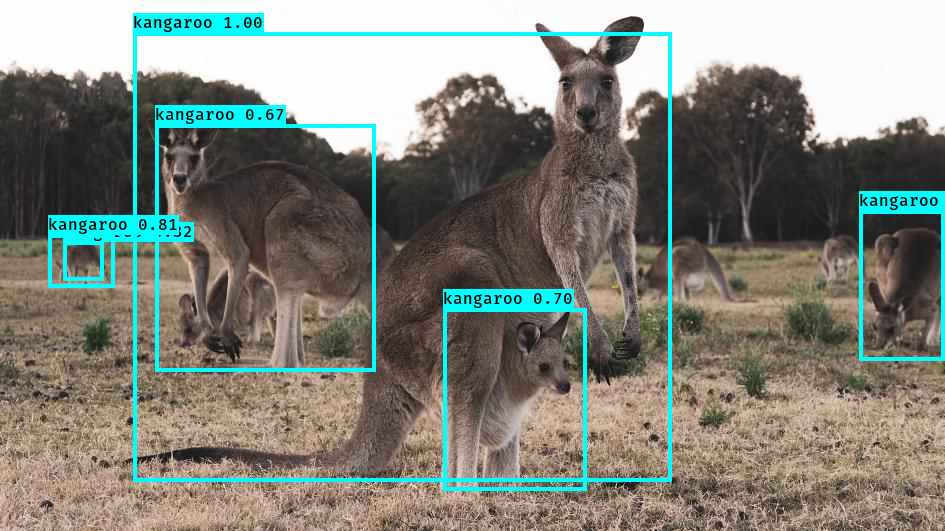

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.42 (313, 354) (604, 659)
0.04194835300222621


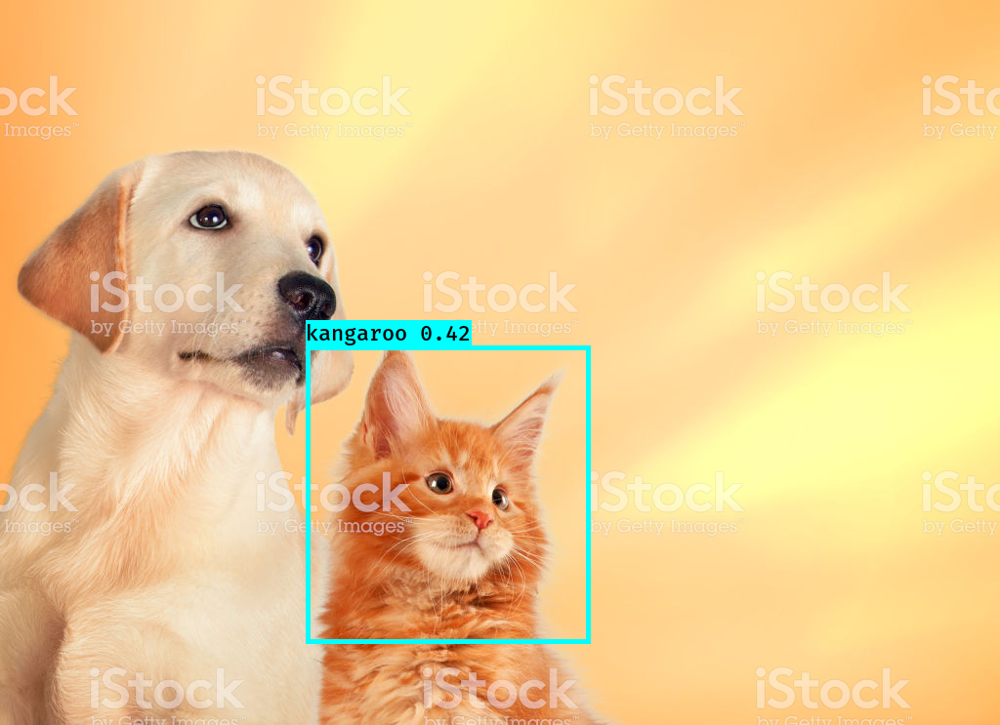

(416, 416, 3)
Found 1 boxes for img
raccoon 1.00 (0, 1) (219, 227)
0.031165197997324867


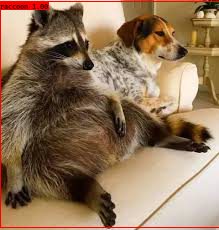

(416, 416, 3)
Found 1 boxes for img
kangaroo 1.00 (142, 44) (536, 587)
0.04328122700098902


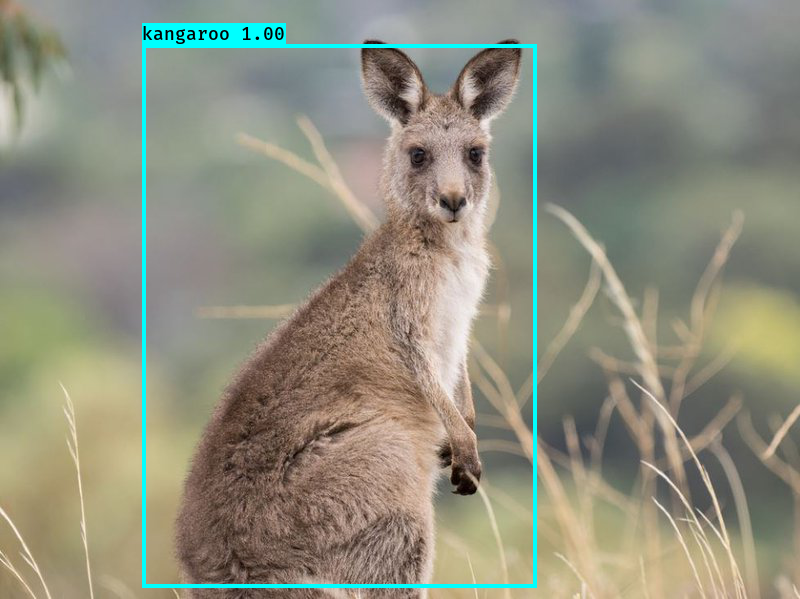

(416, 416, 3)
Found 1 boxes for img
raccoon 1.00 (229, 30) (778, 483)
0.0412884719989961


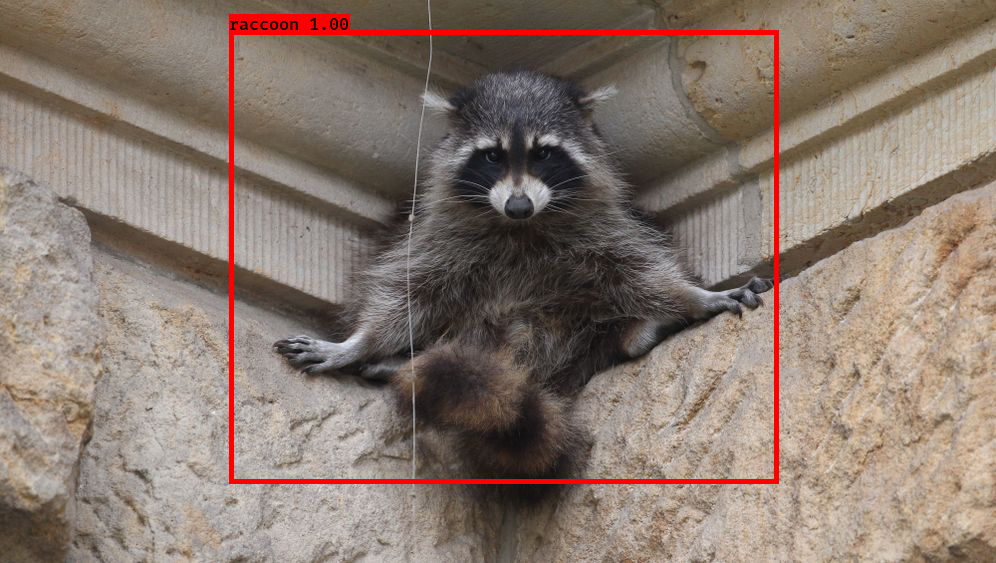

(416, 416, 3)
Found 1 boxes for img
raccoon 0.99 (74, 110) (280, 336)
0.032477970999025274


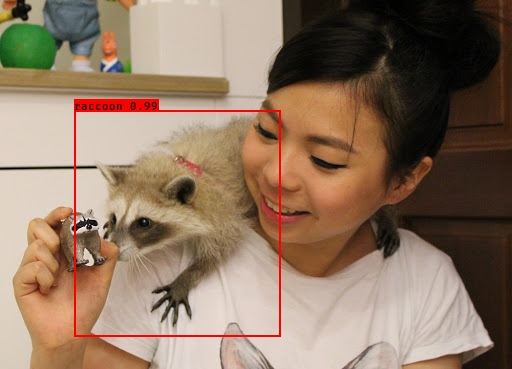

(416, 416, 3)
Found 1 boxes for img
raccoon 0.98 (77, 18) (236, 149)
0.03159719199902611


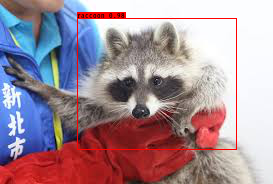

(416, 416, 3)
Found 1 boxes for img
kangaroo 1.00 (9, 160) (936, 748)
0.04987373799667694


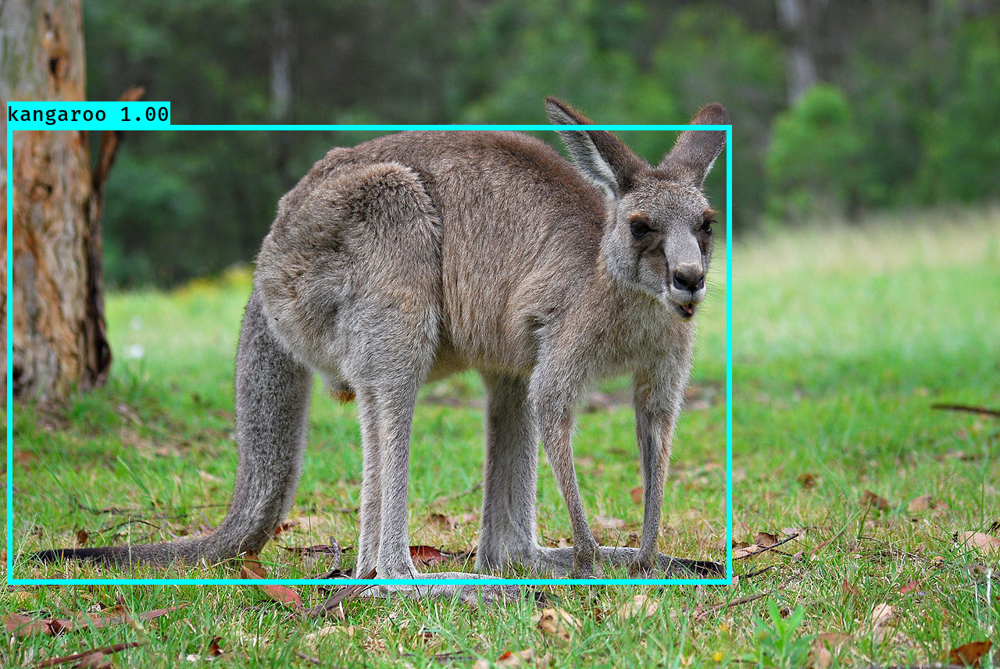

(416, 416, 3)
Found 3 boxes for img
kangaroo 0.86 (14, 134) (520, 680)
kangaroo 0.90 (418, 216) (990, 667)
kangaroo 0.98 (845, 124) (1325, 617)
0.05815125400113175


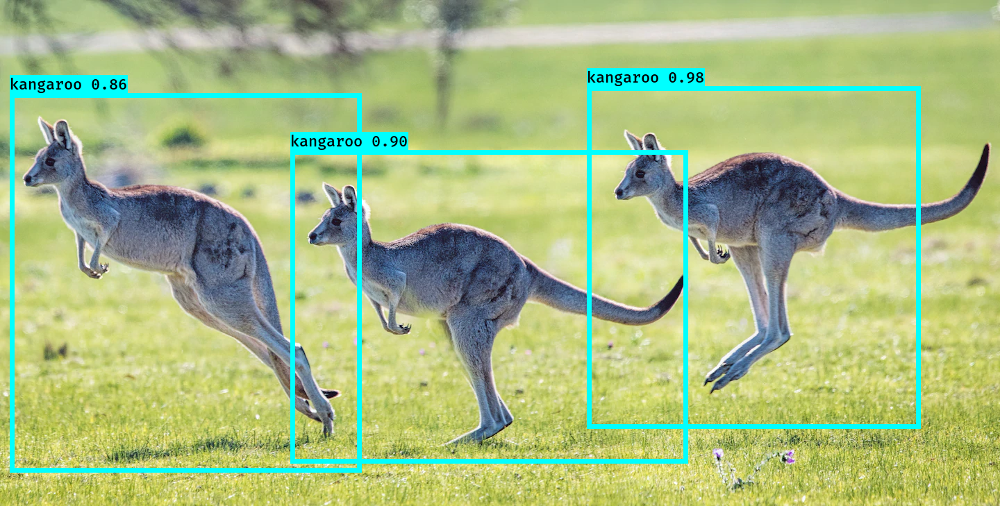

(416, 416, 3)
Found 2 boxes for img
kangaroo 0.89 (259, 339) (504, 937)
kangaroo 1.00 (352, 0) (839, 968)
0.05669701300212182


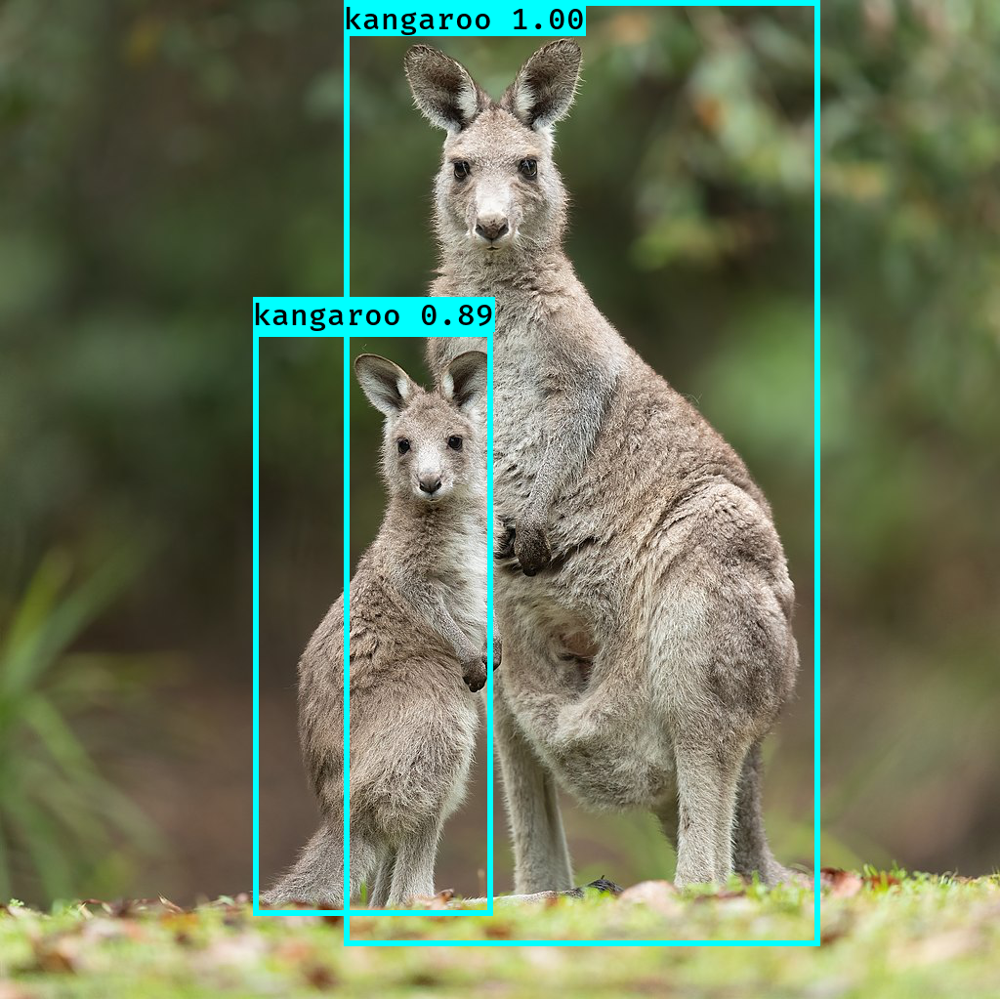

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.99 (660, 159) (1021, 709)
0.049439468999480596


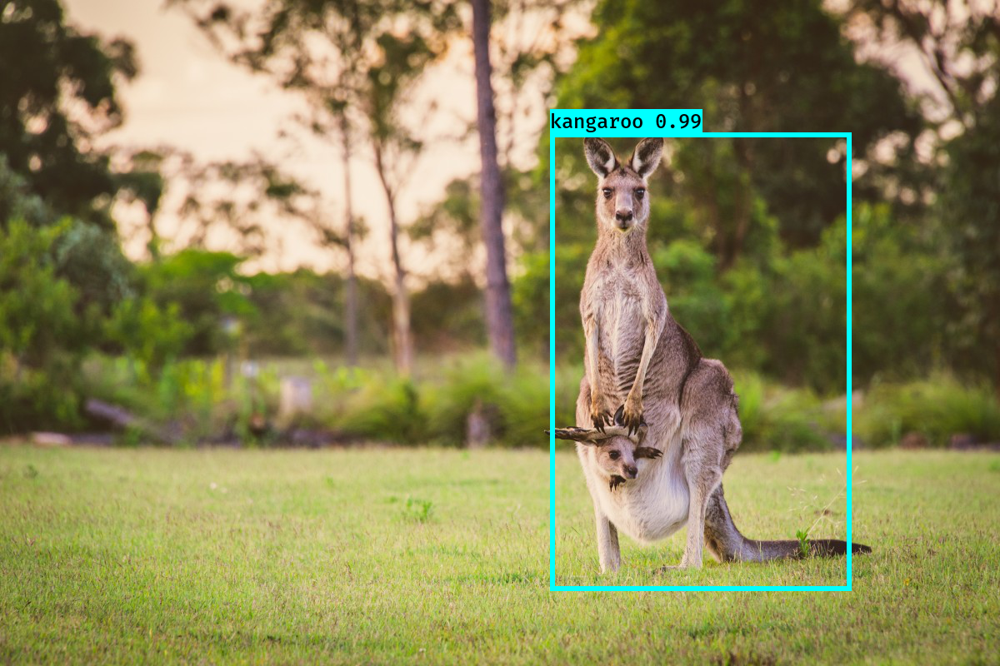

(416, 416, 3)
Found 1 boxes for img
kangaroo 0.99 (116, 2) (271, 183)
0.0362208799997461


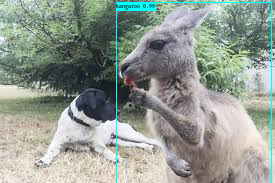

(416, 416, 3)
Found 2 boxes for img
kangaroo 0.93 (60, 10) (178, 198)
kangaroo 0.95 (182, 74) (358, 224)
0.038752419997763354


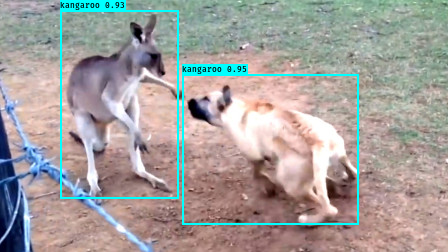

(416, 416, 3)
Found 2 boxes for img
raccoon 1.00 (3, 38) (354, 366)
raccoon 1.00 (316, 0) (512, 297)
0.03910858899689629


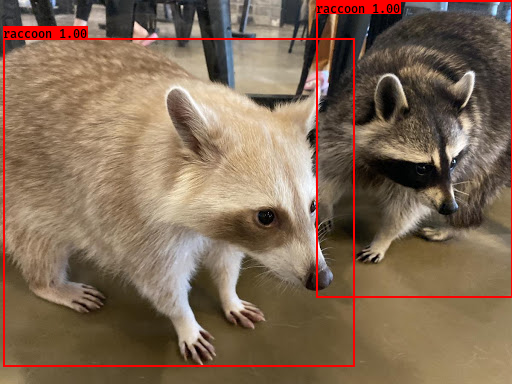

(416, 416, 3)
Found 2 boxes for img
raccoon 0.96 (196, 148) (709, 1011)
raccoon 1.00 (630, 116) (1246, 1067)
0.0670420969981933


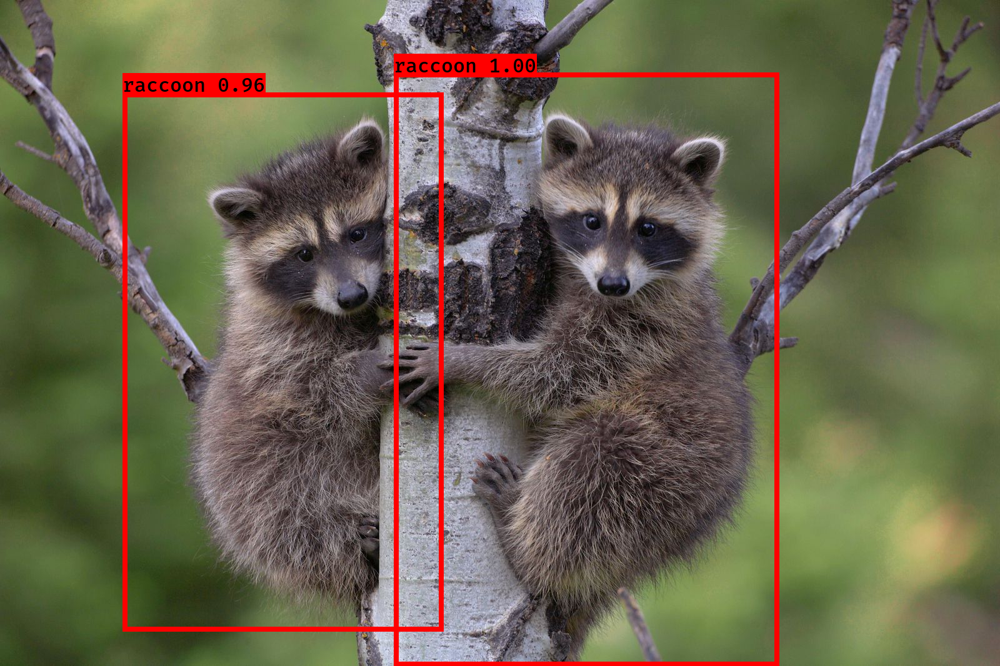

(416, 416, 3)
Found 3 boxes for img
raccoon 0.35 (484, 235) (702, 391)
raccoon 0.52 (10, 68) (306, 416)
kangaroo 0.97 (10, 10) (393, 403)
0.050786200001311954


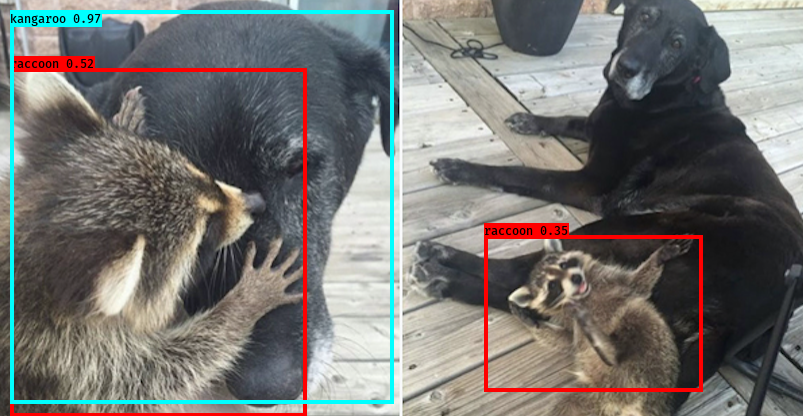

(416, 416, 3)
Found 1 boxes for img
raccoon 1.00 (0, 347) (571, 654)
0.042070278999744914


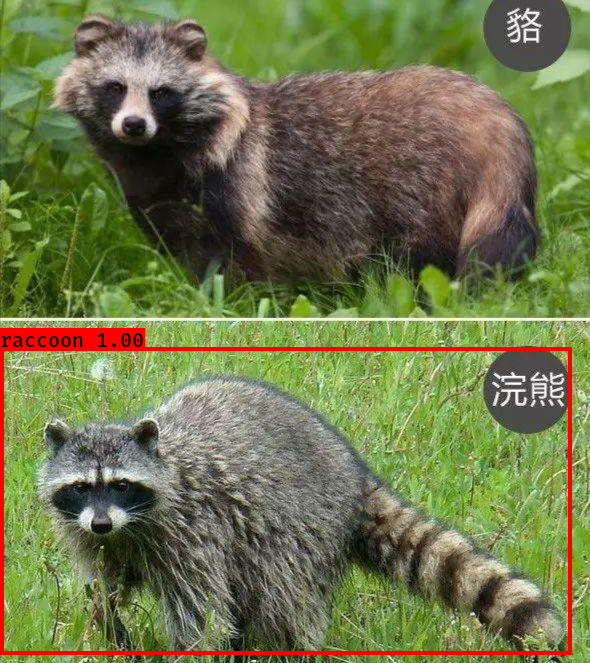

(416, 416, 3)
Found 1 boxes for img
raccoon 1.00 (29, 45) (252, 200)
0.03644240900030127


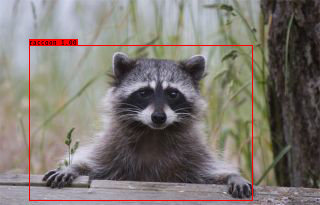

In [17]:
for file in os.listdir('../test_img/'):
    img = Image.open(os.path.join('../test_img/', file))
    r_img = yolo_model.detect_image(img)
    display.display(r_img)

In [27]:
print(log_dir)

logs/1582949709/


In [25]:
import matplotlib.pyplot as plt

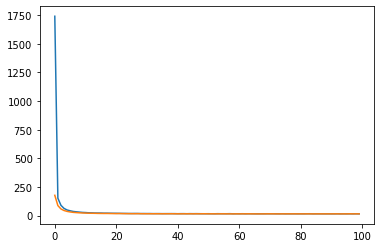

In [26]:
plt.plot(history.epoch, history.history['loss'], history.epoch, history.history['val_loss'])